In [ ]:
# Installing  dependencies
!pip install ultralytics --quiet  # YOLOv8
!pip install kaggle --quiet       # Kaggle API

import os, shutil, random
import xml.etree.ElementTree as ET


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 26.7 MB/s eta 0:00:00


In [ ]:
# uploading the kaggle json file
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"maryamiqtidar01","key":"b665ee3c24f358ea4746837904fbc9e3"}'}

In [ ]:
# Setting up Kaggle API (upload kaggle.json first)
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [ ]:
# making the folder in google colab
!kaggle datasets download riotulab/salat-postures --unzip -p /content/salat
DATA_DIR = "/content/salat/Salat-All-img-xml"
print("Dataset ready at:", DATA_DIR)

Dataset URL: https://www.kaggle.com/datasets/riotulab/salat-postures
License(s): Attribution-NonCommercial 4.0 International (CC BY-NC 4.0)
 99% 623M/631M [00:03<00:00, 167MB/s]
100% 631M/631M [00:03<00:00, 203MB/s]
Dataset ready at: /content/salat/Salat-All-img-xml


In [6]:
!ls /content/salat/Salat-All-img-xml | head

10.jpg
10.xml
11.jpg
11.xml
12.jpg
12.xml
13.jpg
13.xml
14.jpg
14.xml


In [ ]:
# defining the classes 
classes = ["qiyam", "ruku", "julus", "sujud"]
class_ids = {cls: i for i, cls in enumerate(classes)}

In [8]:
class_files = {cls: [] for cls in classes}

for xml_file in os.listdir(DATA_DIR):
    if not xml_file.endswith(".xml"):
        continue
    tree = ET.parse(os.path.join(DATA_DIR, xml_file))
    root = tree.getroot()
    obj = root.find("object")
    if obj is not None:
        cls_name = obj.find("name").text.lower()
        if cls_name in classes:
            class_files[cls_name].append(xml_file)

In [9]:
from sklearn.model_selection import train_test_split

train_files, val_files = [], []

for cls, files in class_files.items():
    tr, vl = train_test_split(files, test_size=0.2, random_state=42)
    train_files.extend(tr)
    val_files.extend(vl)

print("Initial train files:", len(train_files))
print("Validation files:", len(val_files))

Initial train files: 1359
Validation files: 342


In [11]:
# -------------------------------
# Step 6: Balance training set by duplicating smaller classes (robust version)
# -------------------------------
def get_image_file(xml_file):
    """Return the actual image filename matching an XML, checking common extensions."""
    base = xml_file.replace(".xml", "")
    for ext in [".png", ".jpg", ".jpeg"]:
        img_path = os.path.join(DATA_DIR, base + ext)
        if os.path.exists(img_path):
            return base + ext
    print(f"WARNING: Image not found for {xml_file}")
    return None

max_count = max(len([f for f in train_files if f in class_files[cls]]) for cls in classes)
balanced_train_files = train_files.copy()

for cls in classes:
    cls_train_files = [f for f in train_files if f in class_files[cls]]
    while len(cls_train_files) < max_count:
        f = random.choice(cls_train_files)
        img_file = get_image_file(f)
        if img_file is None:
            # Skip if corresponding image does not exist
            cls_train_files.remove(f)
            continue

        # Create duplicated filenames
        new_img_name = img_file.replace(".", f"_dup{len(cls_train_files)}.")
        new_xml_name = f.replace(".xml", f"_dup{len(cls_train_files)}.xml")

        # Copy files
        shutil.copy(os.path.join(DATA_DIR, img_file), os.path.join(DATA_DIR, new_img_name))
        shutil.copy(os.path.join(DATA_DIR, f), os.path.join(DATA_DIR, new_xml_name))

        # Add to lists
        cls_train_files.append(new_xml_name)
        balanced_train_files.append(new_xml_name)

print("Balanced training set:", len(balanced_train_files))


Balanced training set: 1672


In [12]:
# -------------------------------
# Step 7: Create YOLO folders
# -------------------------------
BASE_DIR = "/content/salat/yolo"
for split in ["train", "val"]:
    os.makedirs(f"{BASE_DIR}/{split}/images", exist_ok=True)
    os.makedirs(f"{BASE_DIR}/{split}/labels", exist_ok=True)

In [13]:
# -------------------------------
# Step 8: Safe XML -> YOLO conversion
# Handles both <bndbox> and <polygon>
# -------------------------------
def convert_to_yolo(xml_list, split):
    for xml_file in xml_list:
        xml_path = os.path.join(DATA_DIR, xml_file)
        img_path = os.path.join(DATA_DIR, xml_file.replace(".xml", ".png"))

        if not os.path.exists(img_path):
            print(f"Image missing: {img_path}")
            continue

        tree = ET.parse(xml_path)
        root = tree.getroot()

        try:
            w = int(root.find("size/width").text)
            h = int(root.find("size/height").text)
        except:
            print(f"Invalid width/height in {xml_file}, skipping")
            continue
        if w == 0 or h == 0:
            print(f"Zero width/height in {xml_file}, skipping")
            continue

        yolo_lines = []

        for obj in root.findall("object"):
            cls = obj.find("name").text.lower()
            if cls not in classes:
                continue
            cls_id = class_ids[cls]

            box = obj.find("bndbox")
            if box is not None:
                try:
                    xmin = int(box.find("xmin").text)
                    ymin = int(box.find("ymin").text)
                    xmax = int(box.find("xmax").text)
                    ymax = int(box.find("ymax").text)
                except:
                    continue
            elif obj.find("polygon") is not None:
                polygon = obj.find("polygon")
                try:
                    xs = [int(polygon.find(f"x{i}").text) for i in range(1, 5)]
                    ys = [int(polygon.find(f"y{i}").text) for i in range(1, 5)]
                    xmin = min(xs)
                    ymin = min(ys)
                    xmax = max(xs)
                    ymax = max(ys)
                except:
                    continue
            else:
                continue

            if xmax - xmin == 0 or ymax - ymin == 0:
                continue

            # YOLO format
            x_center = ((xmin + xmax) / 2) / w
            y_center = ((ymin + ymax) / 2) / h
            width = (xmax - xmin) / w
            height = (ymax - ymin) / h
            yolo_lines.append(f"{cls_id} {x_center} {y_center} {width} {height}")

        if yolo_lines:
            label_path = f"{BASE_DIR}/{split}/labels/{xml_file.replace('.xml','.txt')}"
            with open(label_path, "w") as f:
                f.write("\n".join(yolo_lines))
            shutil.copy(img_path, f"{BASE_DIR}/{split}/images/{os.path.basename(img_path)}")

# Run conversion
convert_to_yolo(balanced_train_files, "train")
convert_to_yolo(val_files, "val")
print("Conversion complete!")


Image missing: /content/salat/Salat-All-img-xml/qiam(243).png
Image missing: /content/salat/Salat-All-img-xml/qiam(41).png
Image missing: /content/salat/Salat-All-img-xml/qiam(249).png
Image missing: /content/salat/Salat-All-img-xml/qiam(68).png
Image missing: /content/salat/Salat-All-img-xml/qiam(80).png
Image missing: /content/salat/Salat-All-img-xml/ck2up9ba3r4lo0721dieabmzp.png
Image missing: /content/salat/Salat-All-img-xml/qiam(200).png
Image missing: /content/salat/Salat-All-img-xml/qiam(266).png
Image missing: /content/salat/Salat-All-img-xml/qiam(261).png
Image missing: /content/salat/Salat-All-img-xml/qiam(62).png
Image missing: /content/salat/Salat-All-img-xml/qiam(107).png
Image missing: /content/salat/Salat-All-img-xml/ck2upwc9erc9g0721ci2n9n8q.png
Image missing: /content/salat/Salat-All-img-xml/qiam(153).png
Image missing: /content/salat/Salat-All-img-xml/ck2qcfa2rkho8083878ojzlm5.png
Image missing: /content/salat/Salat-All-img-xml/ck35vn099ddn50838mglb21at.png
Image miss

In [14]:
# Step 9: Create YOLO dataset config
# -------------------------------
yaml_content = f"""
path: {BASE_DIR}
train: train/images
val: val/images

nc: {len(classes)}
names: {classes}
"""

with open(f"{BASE_DIR}/salat.yaml", "w") as f:
    f.write(yaml_content)

print("YOLO config created at:", f"{BASE_DIR}/salat.yaml")

YOLO config created at: /content/salat/yolo/salat.yaml


In [15]:
# -------------------------------
# Step 10: Train YOLOv8 (fast mode)
# -------------------------------
from ultralytics import YOLO

model = YOLO("yolov8n.pt")  # YOLOv8 nano for fast training
model.train(
    data=f"{BASE_DIR}/salat.yaml",
    epochs=30,
    imgsz=640,
    batch=16,
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.253 🚀 Python-3.12.12 torch-2.9.0+cpu CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/salat/yolo/salat.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a2f38af1eb0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04

Found 29 testing images.

image 1/1 /content/salat/yolo/val/images/ck2oter2sn9kz0725f9dxm2ca.png: 640x352 1 ruku, 156.8ms
Speed: 3.1ms preprocess, 156.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 352)


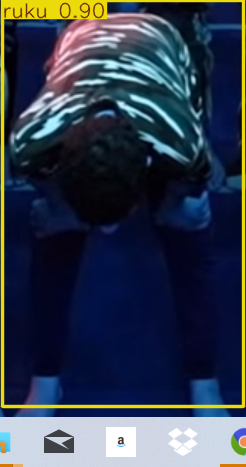


image 1/1 /content/salat/yolo/val/images/ruku86.png: 384x640 2 rukus, 155.5ms
Speed: 3.4ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


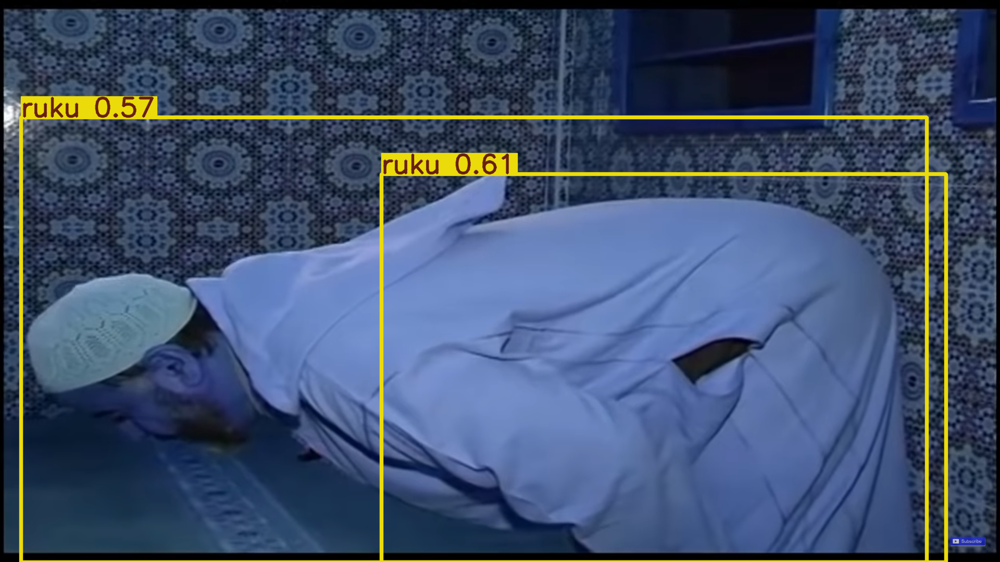


image 1/1 /content/salat/yolo/val/images/ruku110.png: 384x640 2 rukus, 150.0ms
Speed: 4.3ms preprocess, 150.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


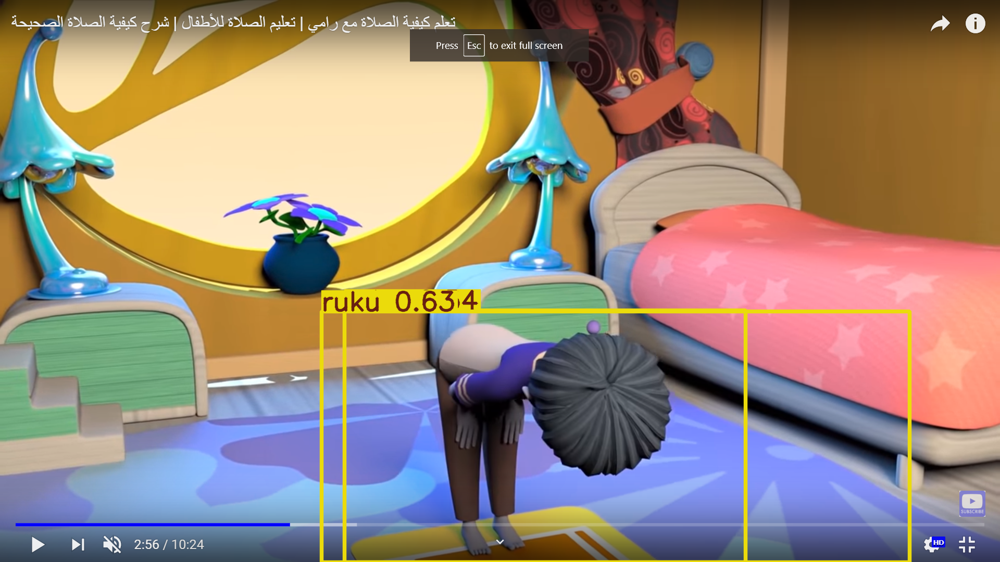


image 1/1 /content/salat/yolo/val/images/ruku177.png: 384x640 1 ruku, 222.7ms
Speed: 4.2ms preprocess, 222.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


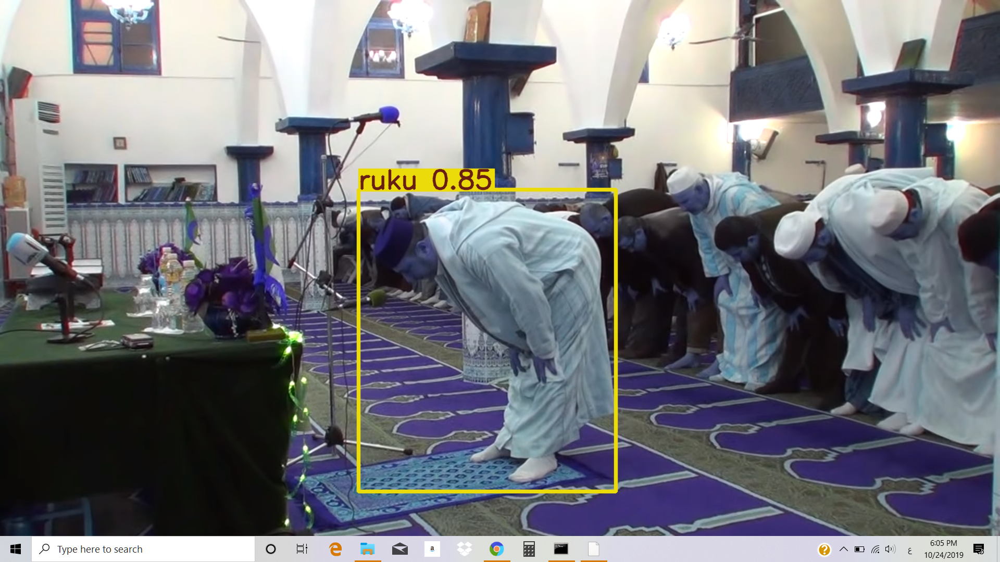


image 1/1 /content/salat/yolo/val/images/ck2ostbxsi3840811chej40k0.png: 640x352 2 rukus, 217.4ms
Speed: 3.6ms preprocess, 217.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 352)


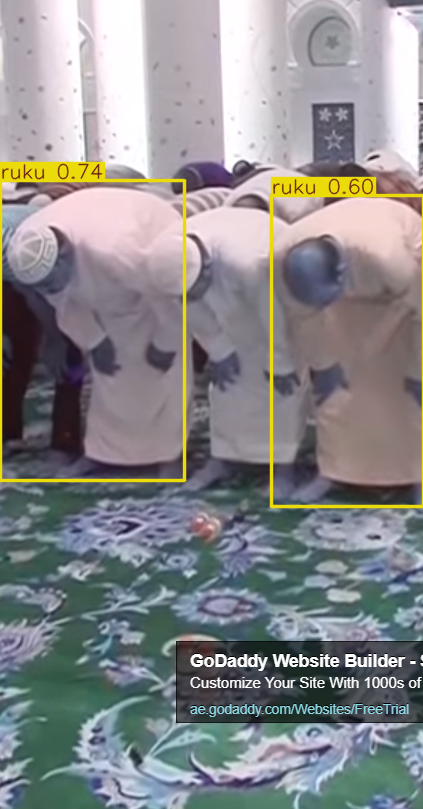


image 1/1 /content/salat/yolo/val/images/ruku198.png: 384x640 2 rukus, 253.3ms
Speed: 5.5ms preprocess, 253.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


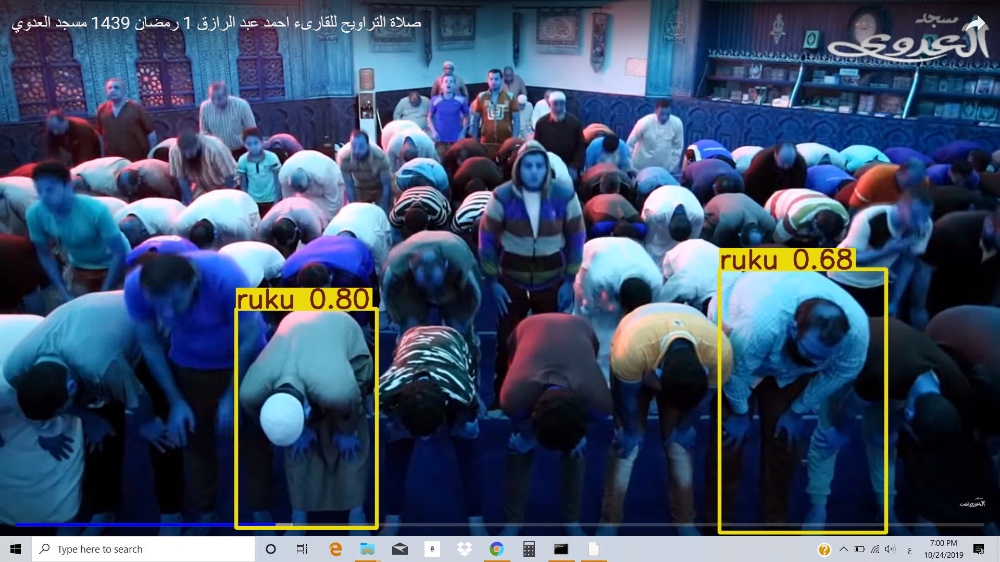


image 1/1 /content/salat/yolo/val/images/ruku90.png: 384x640 1 ruku, 210.9ms
Speed: 4.9ms preprocess, 210.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


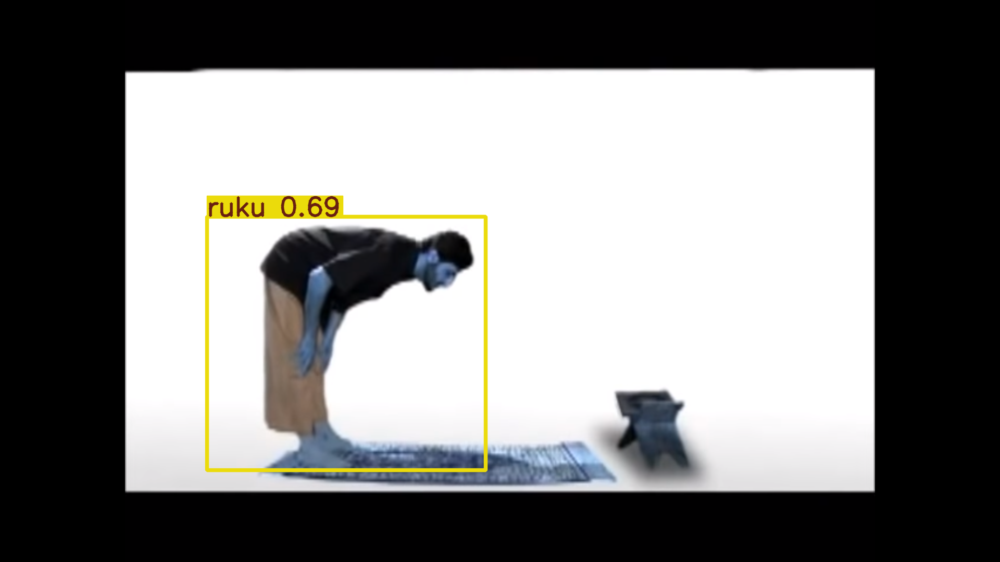


image 1/1 /content/salat/yolo/val/images/ruku194.png: 640x320 1 ruku, 219.7ms
Speed: 3.4ms preprocess, 219.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 320)


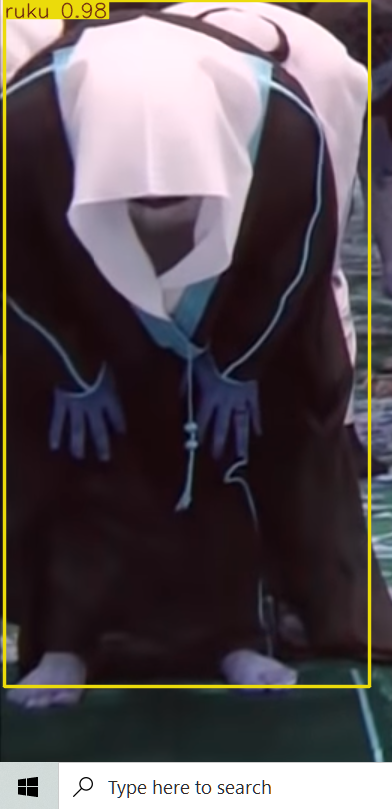


image 1/1 /content/salat/yolo/val/images/ruku115.png: 384x640 1 ruku, 217.8ms
Speed: 4.3ms preprocess, 217.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


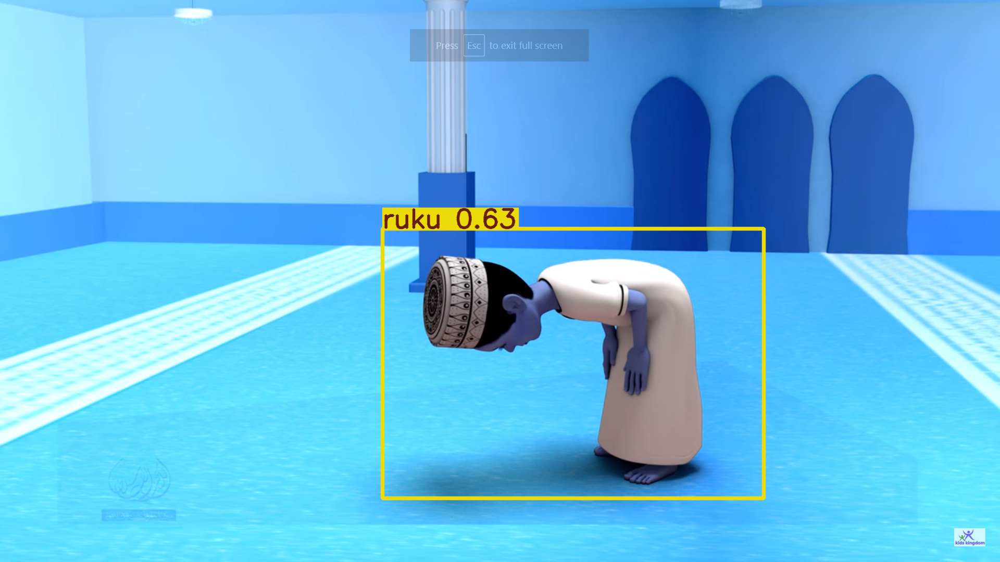


image 1/1 /content/salat/yolo/val/images/ck2rm11retcnu0748mc6x2o91.png: 640x384 1 qiyam, 227.4ms
Speed: 4.8ms preprocess, 227.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


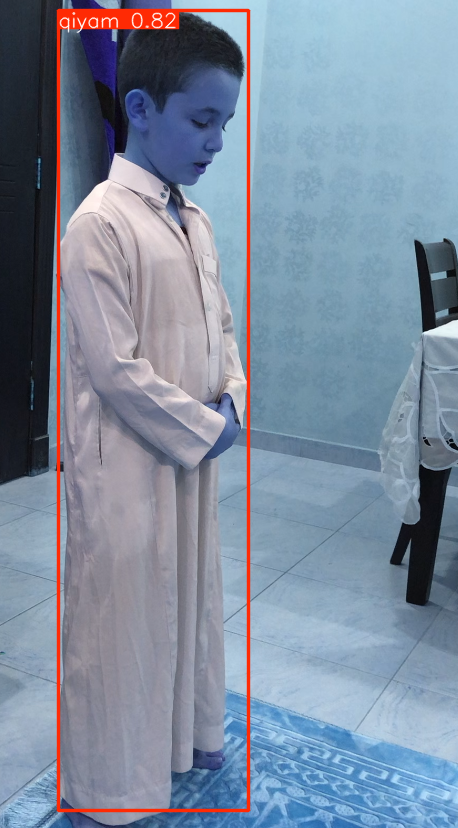


image 1/1 /content/salat/yolo/val/images/ck2osu7liw7lb0794xx9ot8tq.png: 384x640 1 ruku, 222.0ms
Speed: 4.4ms preprocess, 222.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


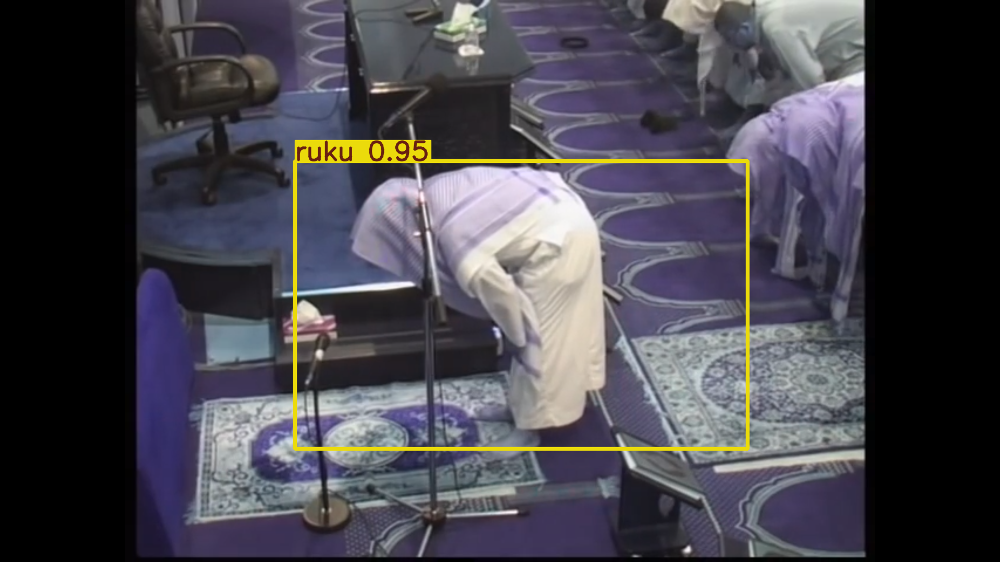


image 1/1 /content/salat/yolo/val/images/ck2rttdato69f07251zl49s9o.png: 640x480 1 julus, 265.7ms
Speed: 4.5ms preprocess, 265.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


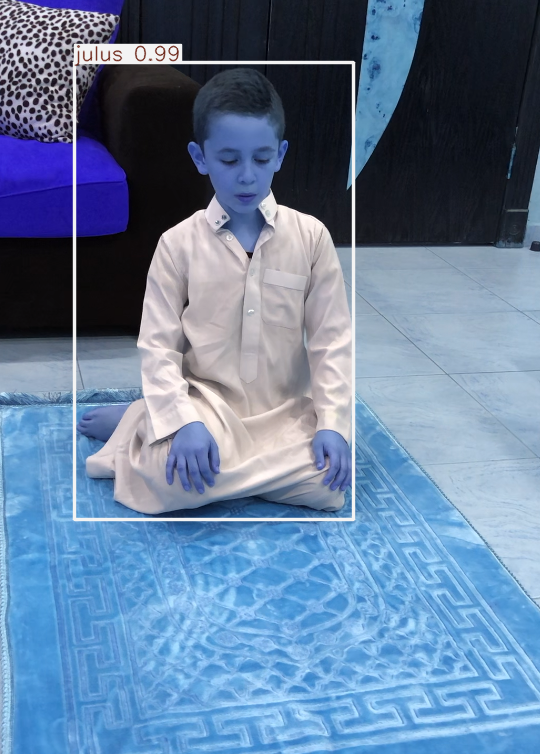


image 1/1 /content/salat/yolo/val/images/ruku105.png: 384x640 1 ruku, 215.3ms
Speed: 4.2ms preprocess, 215.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


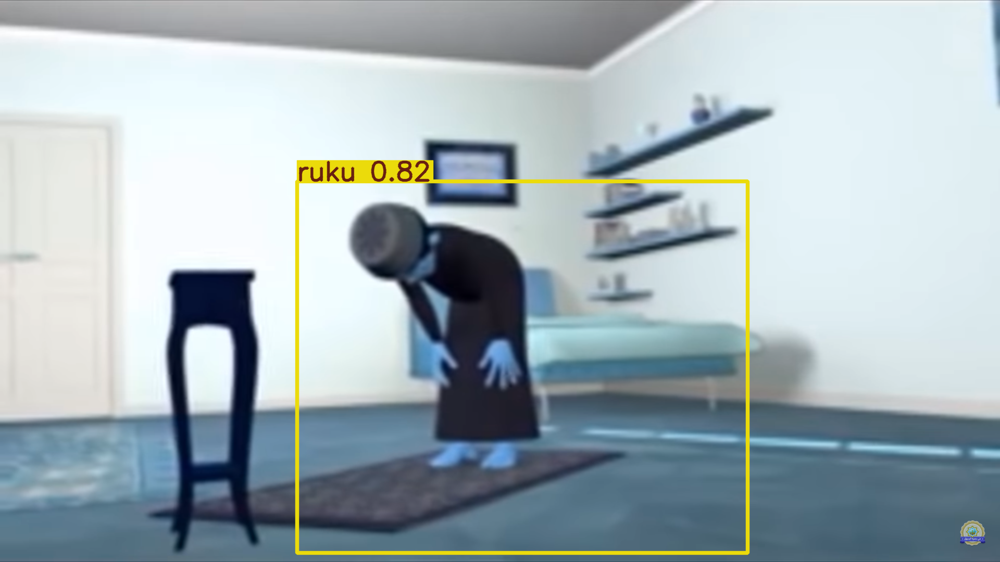


image 1/1 /content/salat/yolo/val/images/ruku94.png: 384x640 1 ruku, 219.2ms
Speed: 5.2ms preprocess, 219.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


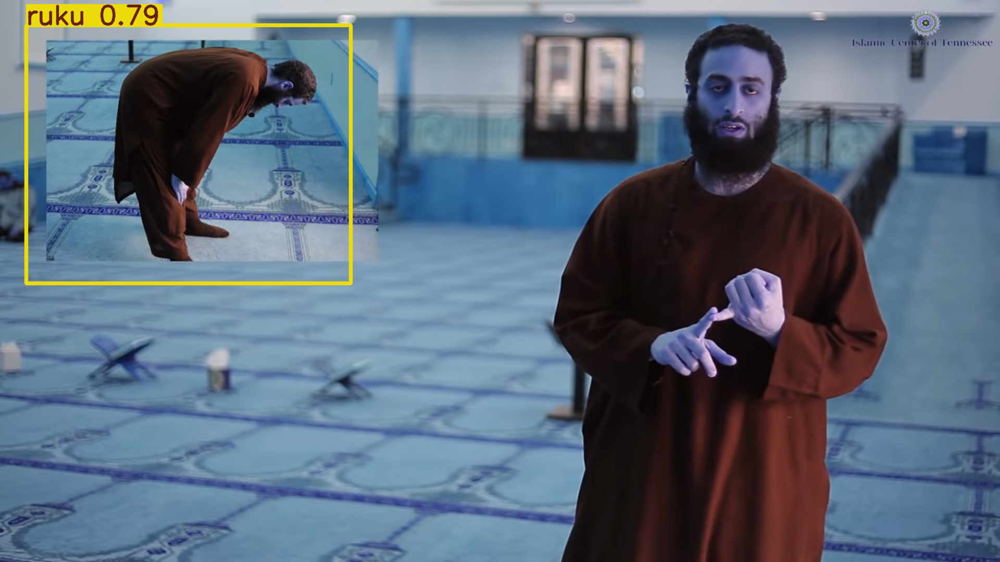


image 1/1 /content/salat/yolo/val/images/ck2osc21p0t740944nixjyk7d.png: 640x320 1 ruku, 194.7ms
Speed: 3.4ms preprocess, 194.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 320)


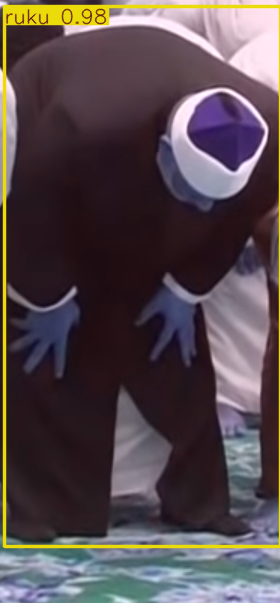


image 1/1 /content/salat/yolo/val/images/ck2oth5dc5xxk07570b711dda.png: 640x256 1 ruku, 167.9ms
Speed: 2.7ms preprocess, 167.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 256)


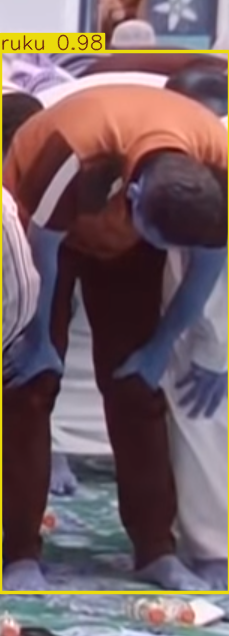


image 1/1 /content/salat/yolo/val/images/ck2os1y3zmmf907250z3634fb.png: 480x640 1 ruku, 256.9ms
Speed: 3.7ms preprocess, 256.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


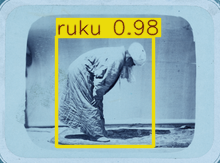


image 1/1 /content/salat/yolo/val/images/ruku66.png: 640x352 2 rukus, 208.6ms
Speed: 3.5ms preprocess, 208.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 352)


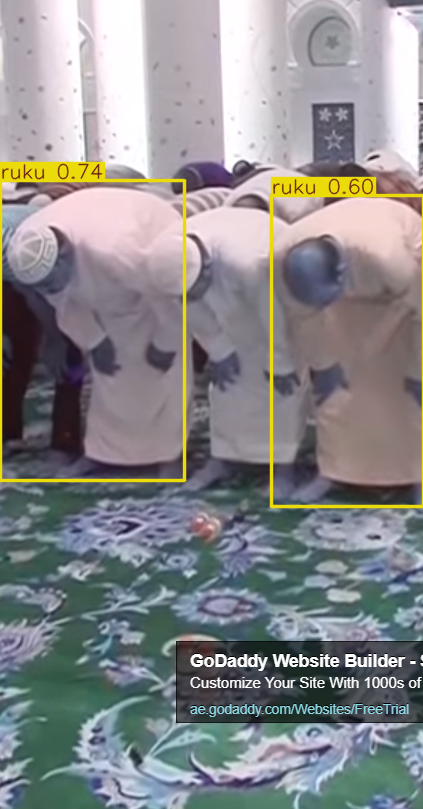


image 1/1 /content/salat/yolo/val/images/ruku199.png: 384x640 5 rukus, 234.6ms
Speed: 4.1ms preprocess, 234.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


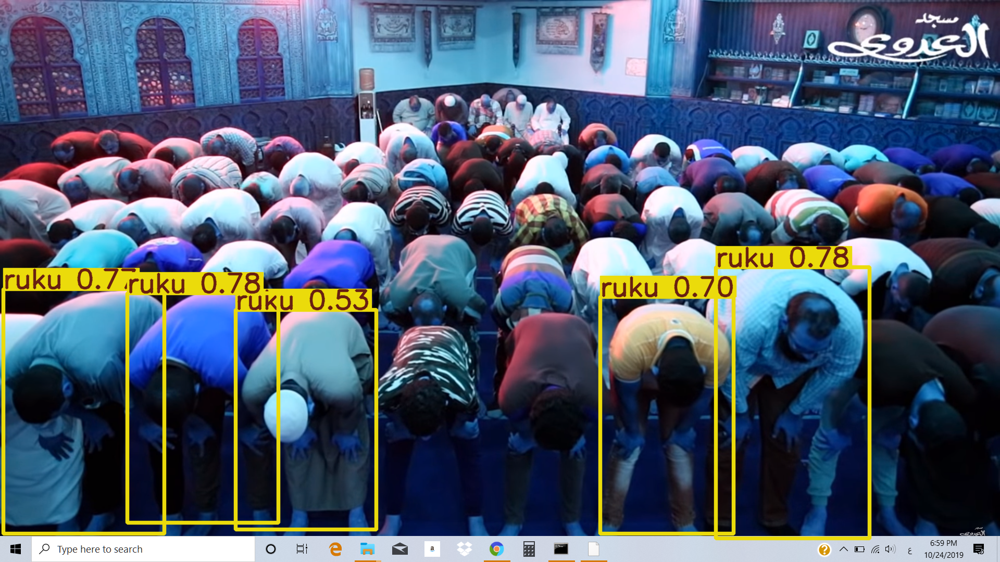


image 1/1 /content/salat/yolo/val/images/ruku111.png: 384x640 1 ruku, 203.9ms
Speed: 4.0ms preprocess, 203.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


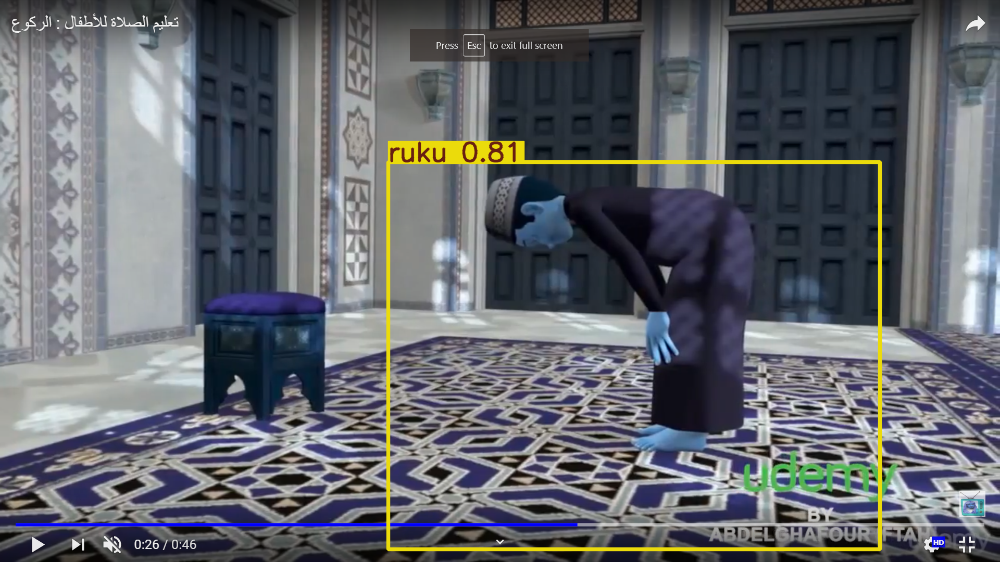


image 1/1 /content/salat/yolo/val/images/ruku88.png: 384x640 1 ruku, 215.9ms
Speed: 4.2ms preprocess, 215.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


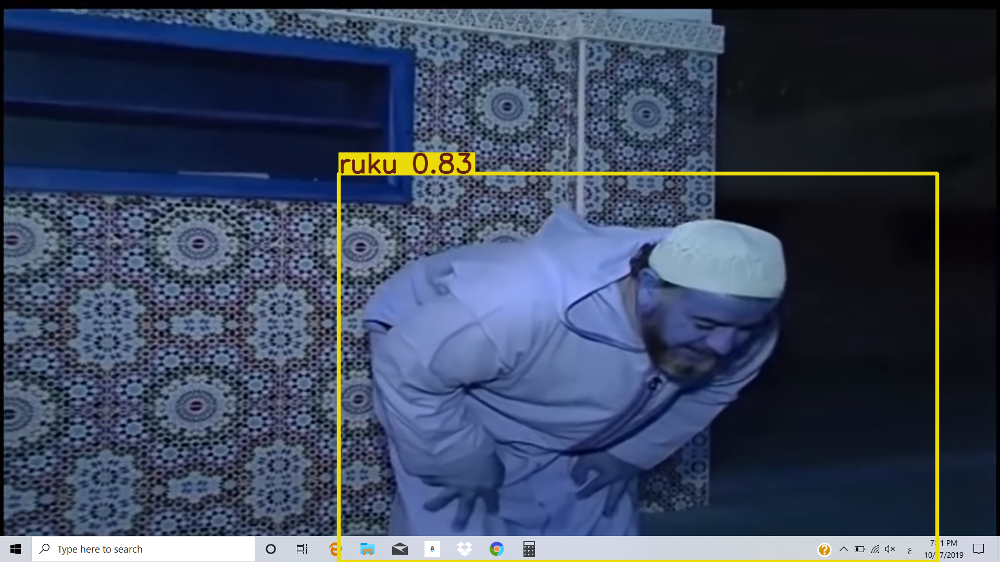


image 1/1 /content/salat/yolo/val/images/ruku188.png: 640x224 1 ruku, 176.1ms
Speed: 2.3ms preprocess, 176.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 224)


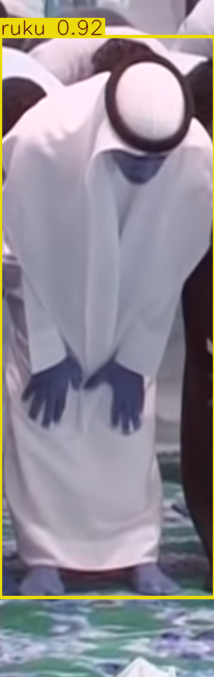


image 1/1 /content/salat/yolo/val/images/ck2oqvo2khdp308118l6vjf3w.png: 640x352 2 rukus, 247.1ms
Speed: 5.4ms preprocess, 247.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 352)


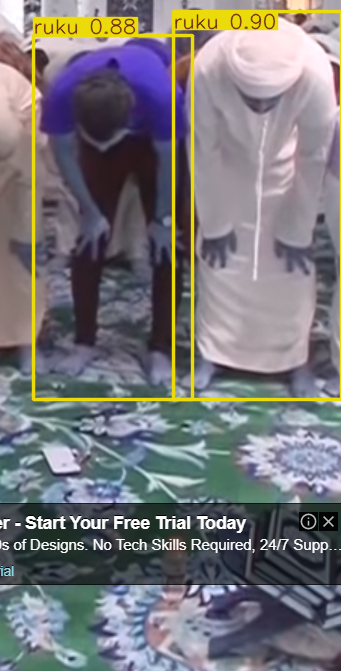


image 1/1 /content/salat/yolo/val/images/ck2orza3g59qi0757qg8cw0ki.png: 384x640 1 ruku, 217.6ms
Speed: 4.4ms preprocess, 217.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


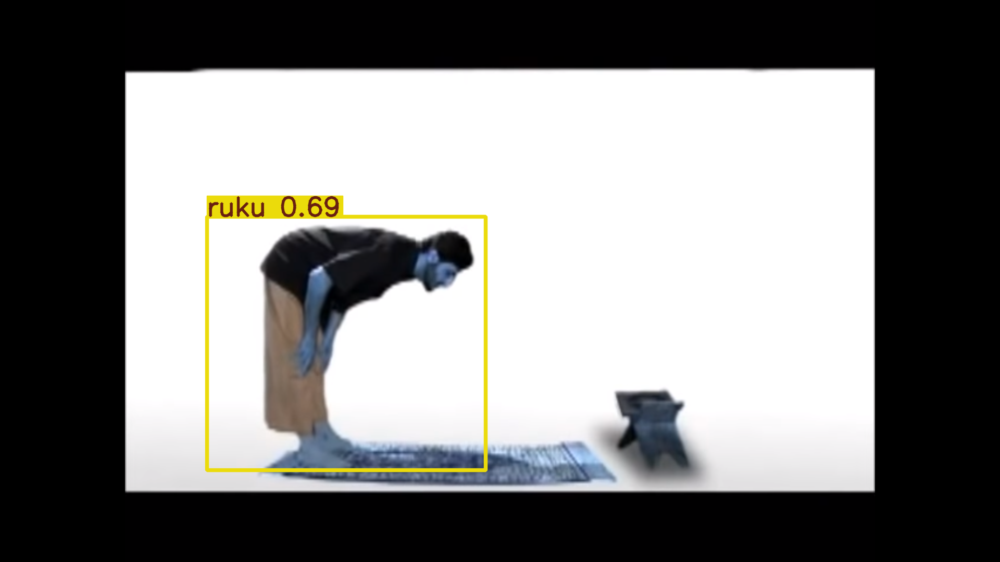


image 1/1 /content/salat/yolo/val/images/ck2rlzp46v2em07945su8d0ww.png: 640x512 1 qiyam, 288.9ms
Speed: 4.9ms preprocess, 288.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 512)


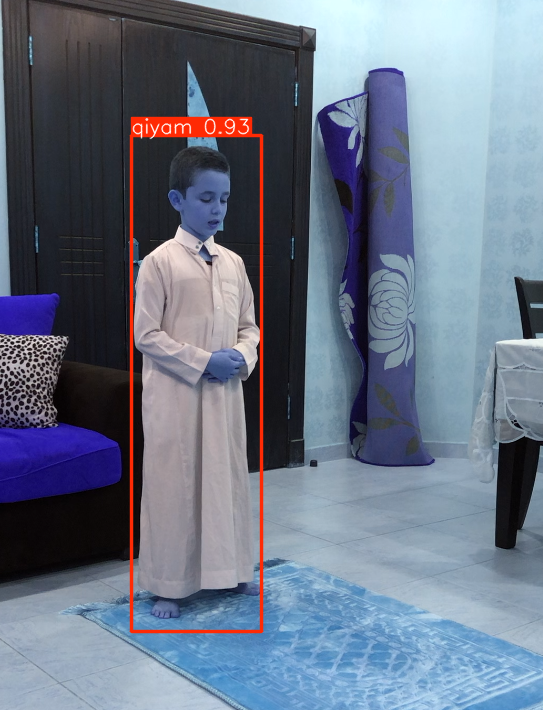


image 1/1 /content/salat/yolo/val/images/ruku95.png: 384x640 (no detections), 228.5ms
Speed: 4.1ms preprocess, 228.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


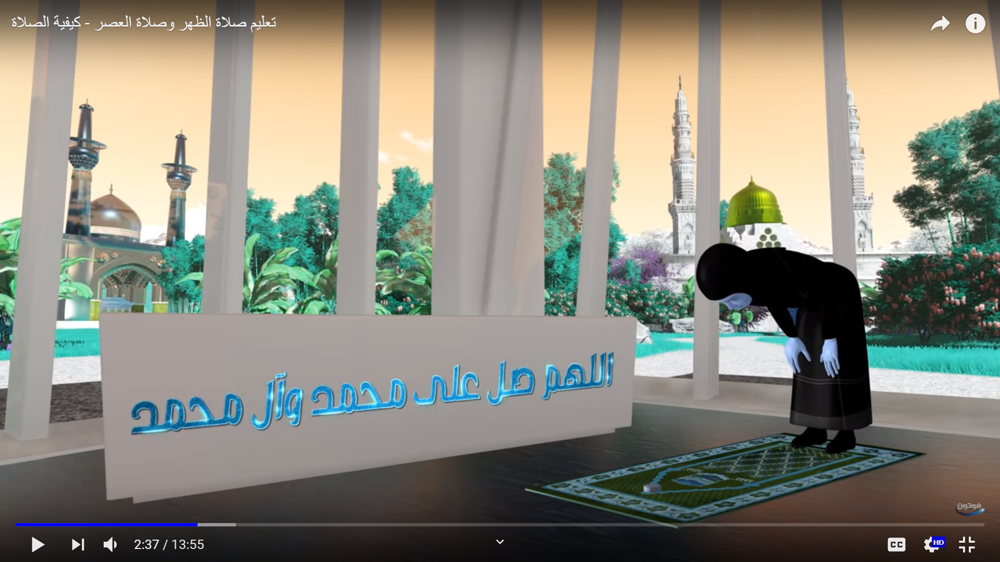


image 1/1 /content/salat/yolo/val/images/ruku190.png: 640x384 1 ruku, 240.2ms
Speed: 3.7ms preprocess, 240.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


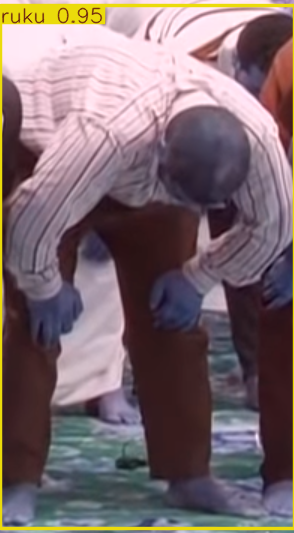


image 1/1 /content/salat/yolo/val/images/ruku193.png: 640x448 1 ruku, 259.5ms
Speed: 4.4ms preprocess, 259.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)


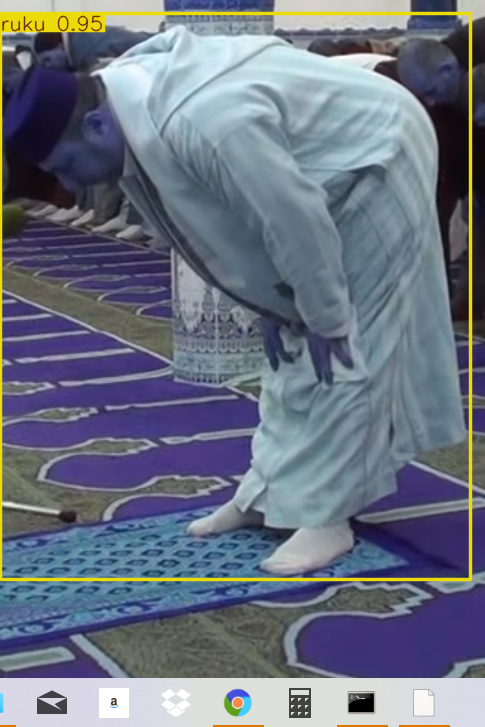


image 1/1 /content/salat/yolo/val/images/ruku100.png: 384x640 (no detections), 224.9ms
Speed: 4.2ms preprocess, 224.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


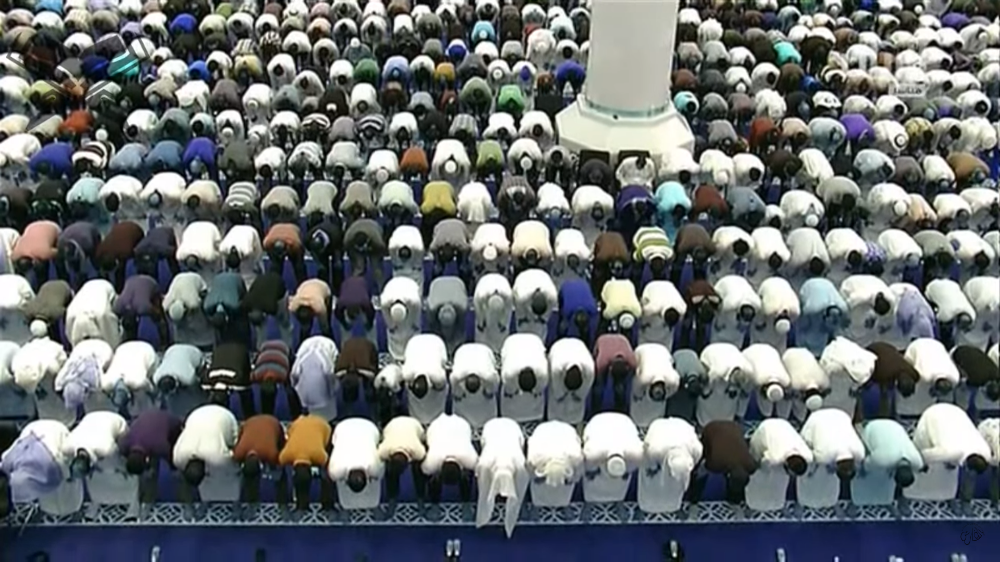

All predictions saved in: /content/salat/yolo/val/predictions


In [27]:
from ultralytics import YOLO
from PIL import Image
from IPython.display import display
import os

# Load the trained YOLOv8 model
weights_path = "/content/runs/detect/train/weights/best.pt"  # adjust if needed
model = YOLO(weights_path)

# Path to validation/test images
test_images_dir = os.path.join(BASE_DIR, "val/images")
test_images = os.listdir(test_images_dir)
test_images = [os.path.join(test_images_dir, f) for f in test_images if f.lower().endswith((".png", ".jpg", ".jpeg"))]

print(f"Found {len(test_images)} testing images.")

# Folder to save predictions
save_dir = os.path.join(BASE_DIR, "val/predictions")
os.makedirs(save_dir, exist_ok=True)

# Run inference on all test images
for img_path in test_images:
    results = model.predict(source=img_path, conf=0.5)

    # Convert results to displayable image
    pred_img = results[0].plot()  # numpy array
    display(Image.fromarray(pred_img))

    # Save predicted image
    img_name = os.path.basename(img_path)
    save_path = os.path.join(save_dir, img_name)
    Image.fromarray(pred_img).save(save_path)

print(f"All predictions saved in: {save_dir}")


In [30]:
from ultralytics import YOLO
import os
import numpy as np
from collections import defaultdict

# Make sure 'classes' is defined
classes = ["qiyam", "ruku", "julus", "sujud"]

# Load trained model
weights_path = "/content/runs/detect/train/weights/best.pt"  # adjust if needed
model = YOLO(weights_path)

# Path to validation/test images
test_images_dir = os.path.join(BASE_DIR, "val/images")
test_images = [os.path.join(test_images_dir, f) for f in os.listdir(test_images_dir)
               if f.lower().endswith((".png", ".jpg", ".jpeg"))]

# Initialize dictionaries to store results
class_counts = defaultdict(int)
class_confidences = defaultdict(list)

# Run inference and collect results
for img_path in test_images:
    results = model.predict(source=img_path, conf=0.5)

    # Loop over detected boxes in this image
    for det in results[0].boxes:
        cls_id = int(det.cls[0])  # class index
        conf = float(det.conf[0]) # confidence
        class_name = classes[cls_id]
        class_counts[class_name] += 1
        class_confidences[class_name].append(conf)

# Print results
print("Detection results on validation set:\n")
for cls in classes:
    count = class_counts.get(cls, 0)
    avg_conf = np.mean(class_confidences[cls]) if class_confidences[cls] else 0
    print(f"{cls}: average confidence = {avg_conf:.2f}")



image 1/1 /content/salat/yolo/val/images/ck2oter2sn9kz0725f9dxm2ca.png: 640x352 1 ruku, 468.1ms
Speed: 5.6ms preprocess, 468.1ms inference, 7.8ms postprocess per image at shape (1, 3, 640, 352)

image 1/1 /content/salat/yolo/val/images/ruku86.png: 384x640 2 rukus, 265.0ms
Speed: 4.0ms preprocess, 265.0ms inference, 3.8ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/salat/yolo/val/images/ruku110.png: 384x640 2 rukus, 229.0ms
Speed: 3.9ms preprocess, 229.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/salat/yolo/val/images/ruku177.png: 384x640 1 ruku, 532.8ms
Speed: 4.0ms preprocess, 532.8ms inference, 5.6ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/salat/yolo/val/images/ck2ostbxsi3840811chej40k0.png: 640x352 2 rukus, 243.2ms
Speed: 11.8ms preprocess, 243.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 352)

image 1/1 /content/salat/yolo/val/images/ruku198.png: 384x640 2 rukus, 139.

In [32]:
import pandas as pd

results_csv = "/content/runs/detect/train/results.csv"
df = pd.read_csv(results_csv)
df.head()


,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,102.277,1.10067,3.43143,1.42828,0.00683,0.89683,0.08534,0.04550,1.21484,3.94156,1.47493,0.000063,0.000063,0.000063
1,2,196.745,1.01359,3.15397,1.40043,0.02252,0.92857,0.26207,0.19939,1.22238,3.87553,1.45623,0.000133,0.000133,0.000133
2,3,285.308,0.98742,2.57815,1.32035,0.04309,0.92063,0.44104,0.35006,1.20736,3.76869,1.44494,0.000198,0.000198,0.000198
3,4,372.794,1.11894,2.12459,1.45725,0.05480,0.90476,0.58289,0.46371,1.27649,3.63806,1.47343,0.000259,0.000259,0.000259
4,5,461.914,1.02745,1.86483,1.38147,0.93230,0.16667,0.29437,0.20375,1.29747,3.45368,1.47685,0.000315,0.000315,0.000315


In [34]:
print(df.columns)


Index(['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')


In [40]:
# Last epoch metrics
last_epoch = df.iloc[-1]

print("Final Training Metrics:")
# print(f"Box loss: {last_epoch['train/box_loss']:.4f}")
# print(f"Class loss: {last_epoch['train/cls_loss']:.4f}")
# print(f"DFL loss: {last_epoch['train/dfl_loss']:.4f}")
print(f"Precision: {last_epoch['metrics/precision(B)']:.2f}")
print(f"Recall: {last_epoch['metrics/recall(B)']:.2f}")
print(f"mAP50: {last_epoch['metrics/mAP50(B)']:.2f}")
print(f"mAP50-95: {last_epoch['metrics/mAP50-95(B)']:.2f}")


Final Training Metrics:
Precision: 0.85
Recall: 0.87
mAP50: 0.93
mAP50-95: 0.72


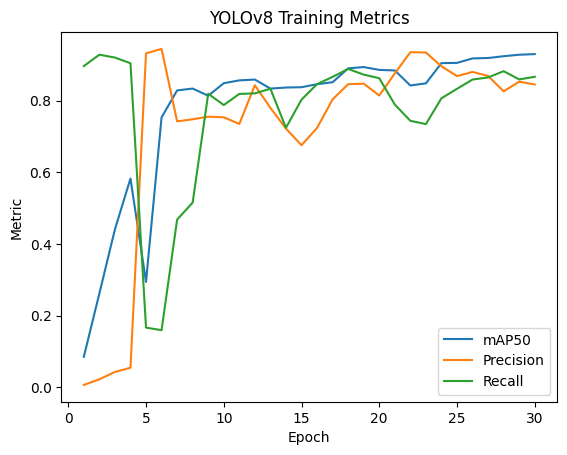

In [39]:
import matplotlib.pyplot as plt

plt.plot(df['epoch'], df['metrics/mAP50(B)'], label='mAP50')
plt.plot(df['epoch'], df['metrics/precision(B)'], label='Precision')
plt.plot(df['epoch'], df['metrics/recall(B)'], label='Recall')
plt.xlabel('Epoch')
plt.ylabel('Metric')
plt.title('YOLOv8 Training Metrics')
plt.legend()
plt.show()
